In [1]:
! pip install opendatasets --upgrade

In [2]:
# import opendatasets as od

# download_url = 'https://www.kaggle.com/sobhanmoosavi/us-accidents'

# od.download(download_url)

## Data Preparation and Cleaning

#### 1. Load the csv file using Pandas
#### 2. Observe some information about the data and the columns
#### 3. Fix any missing or incorrect values

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
data_filename = 'US_Accidents_Dec20_updated.csv'

df = pd.read_csv(data_filename)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1516064 entries, 0 to 1516063
Data columns (total 47 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   ID                     1516064 non-null  object 
 1   Severity               1516064 non-null  int64  
 2   Start_Time             1516064 non-null  object 
 3   End_Time               1516064 non-null  object 
 4   Start_Lat              1516064 non-null  float64
 5   Start_Lng              1516064 non-null  float64
 6   End_Lat                1516064 non-null  float64
 7   End_Lng                1516064 non-null  float64
 8   Distance(mi)           1516064 non-null  float64
 9   Description            1516064 non-null  object 
 10  Number                 469969 non-null   float64
 11  Street                 1516064 non-null  object 
 12  Side                   1516064 non-null  object 
 13  City                   1515981 non-null  object 
 14  County            

In [6]:
df.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,1.516064e+06,1.516064e+06,1.516064e+06,1.516064e+06,1.516064e+06,1.516064e+06,4.699690e+05,1.473031e+06,1.066748e+06,1.470555e+06,1.479790e+06,1.471853e+06,1.387202e+06,1.005515e+06
mean,2.238630e+00,3.690056e+01,-9.859919e+01,3.690061e+01,-9.859901e+01,5.872617e-01,8.907533e+03,5.958460e+01,5.510976e+01,6.465960e+01,2.955495e+01,9.131755e+00,7.630812e+00,8.477855e-03
std,6.081481e-01,5.165653e+00,1.849602e+01,5.165629e+00,1.849590e+01,1.632659e+00,2.242190e+04,1.827316e+01,2.112735e+01,2.325986e+01,1.016756e+00,2.889112e+00,5.637364e+00,1.293168e-01
min,1.000000e+00,2.457022e+01,-1.244976e+02,2.457011e+01,-1.244978e+02,0.000000e+00,0.000000e+00,-8.900000e+01,-8.900000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,3.385422e+01,-1.182076e+02,3.385420e+01,-1.182077e+02,0.000000e+00,1.212000e+03,4.700000e+01,4.080000e+01,4.800000e+01,2.944000e+01,1.000000e+01,4.600000e+00,0.000000e+00
50%,2.000000e+00,3.735113e+01,-9.438100e+01,3.735134e+01,-9.437987e+01,1.780000e-01,4.000000e+03,6.100000e+01,5.700000e+01,6.800000e+01,2.988000e+01,1.000000e+01,7.000000e+00,0.000000e+00
75%,2.000000e+00,4.072593e+01,-8.087469e+01,4.072593e+01,-8.087449e+01,5.940000e-01,1.010000e+04,7.300000e+01,7.100000e+01,8.400000e+01,3.004000e+01,1.000000e+01,1.040000e+01,0.000000e+00
max,4.000000e+00,4.900058e+01,-6.711317e+01,4.907500e+01,-6.710924e+01,1.551860e+02,9.999997e+06,1.706000e+02,1.130000e+02,1.000000e+02,5.804000e+01,1.400000e+02,9.840000e+02,2.400000e+01


In [7]:
numeric_cols = df.select_dtypes(include = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64'])

len(numeric_cols.columns)

14

### Percentage of missing values per column

<AxesSubplot:>

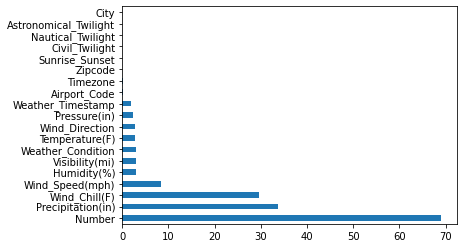

In [8]:
missing_prcnt = round(((df.isna().sum().sort_values(ascending = False)) / len(df)) * 100, 3)
missing_prcnt[missing_prcnt != 0].plot(kind = 'barh')

## Exploratory Analysis and Visualization

#### Columns that we'll be analysing:
#### 1. Severity: We'll be examining the impact of 2 groups of factors on accident severity: Time & Weather
###### a. By Month
###### b. By Day
###### c. By most frequent weather conditions
###### d. By fog, light rain, rain, heavy rain and snow
###### e. By other weather factors

#### 2. Start Time
#### 3. City & County (and hence, State)

#### 1. Severity

In [9]:
print(df['Severity'].value_counts())

2    1212382
3     161052
4     114452
1      28178
Name: Severity, dtype: int64


###### a. By Month

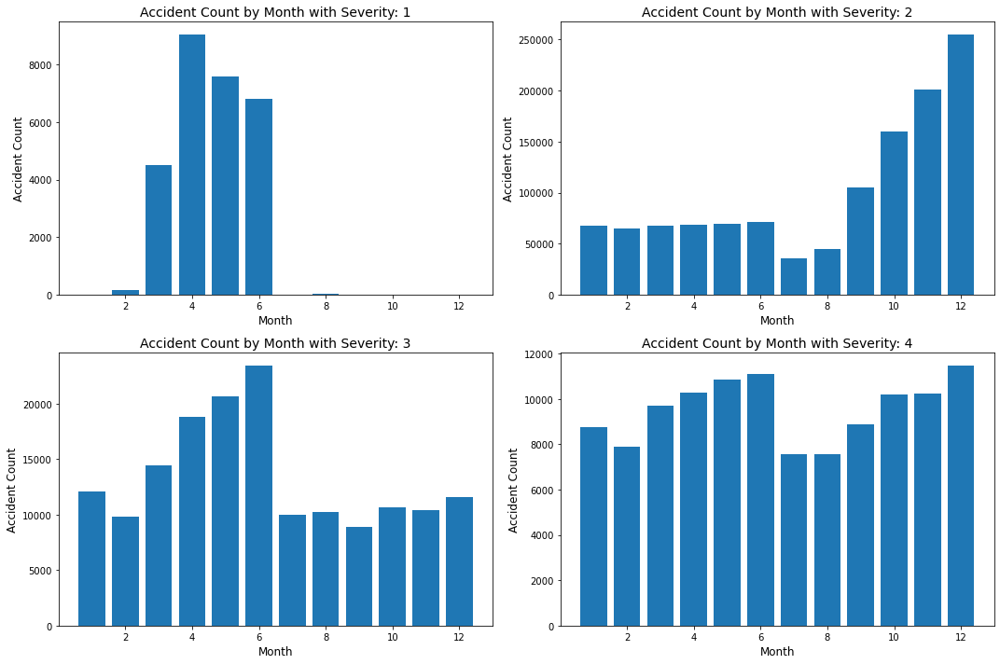

In [10]:
df['time'] = pd.to_datetime(df.Start_Time, format = '%Y-%m-%d %H:%M:%S')

plt.subplots(2, 2, figsize = (15, 10))

for s in np.arange(1, 5):
    plt.subplot(2, 2, s)
    plt.hist(pd.DatetimeIndex(df.loc[df['Severity'] == s]['time']).month, bins = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13],
            align = 'left', rwidth = 0.8)
    plt.title('Accident Count by Month with Severity: '+ str(s), fontsize = 14)
    plt.xlabel('Month', fontsize = 12)
    plt.ylabel('Accident Count', fontsize = 12)
    plt.xticks(fontsize = 10)
    plt.yticks(fontsize = 10)
    
plt.tight_layout()
plt.show()

While fall and winter months could be more dangerous, it is interesting that January and February have lower accident counts. Let's try to find out why is that so...

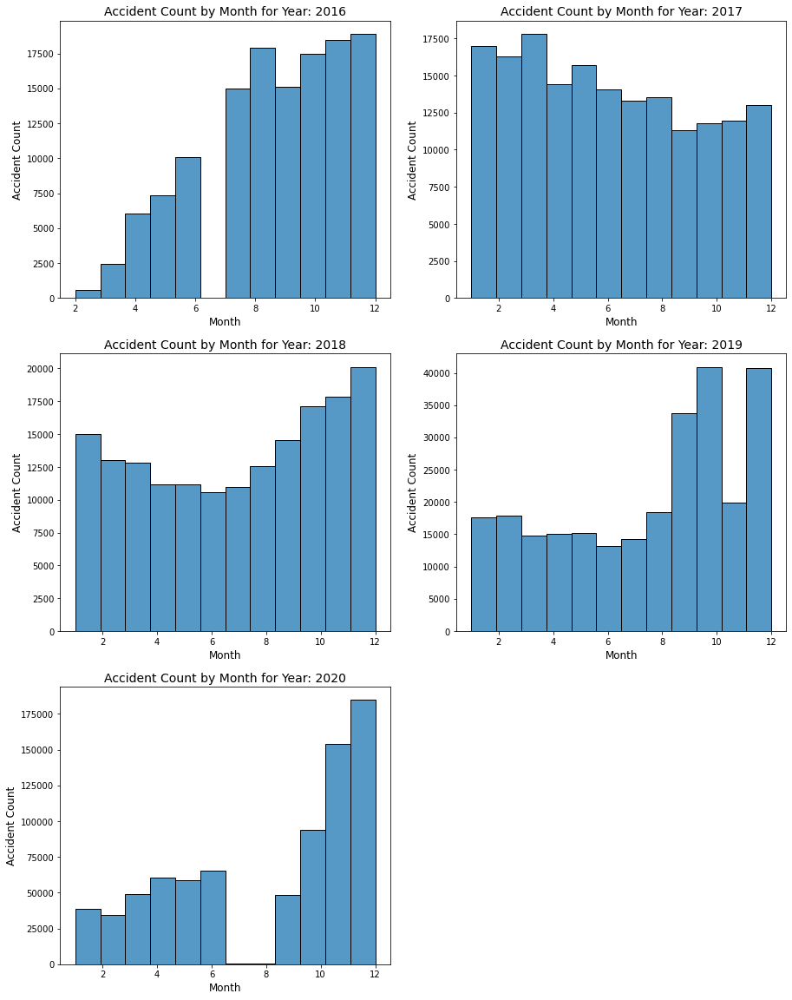

In [11]:
f = plt.figure(figsize = (15, 20))
for i, y in zip(range(5), [2016, 2017, 2018, 2019, 2020]):
    f.add_subplot(3, 2, i + 1)
    df_year = df[df.time.dt.year == y]
    sns.histplot(pd.DatetimeIndex(df_year.time).month, bins = 12, kde = False)
    plt.title('Accident Count by Month for Year: '+ str(y), fontsize = 14)
    plt.xlabel('Month', fontsize = 12)
    plt.ylabel('Accident Count', fontsize = 12)
    plt.xticks(fontsize = 10)
    plt.yticks(fontsize = 10)
plt.show()

As it can be seen from the Accident Count vs Month graphs for the years 2016 through 2020, there are major anomalies in the data of the year 2016 and 2020, probably much of the data is missing for specific months of these years.

###### b. By Day

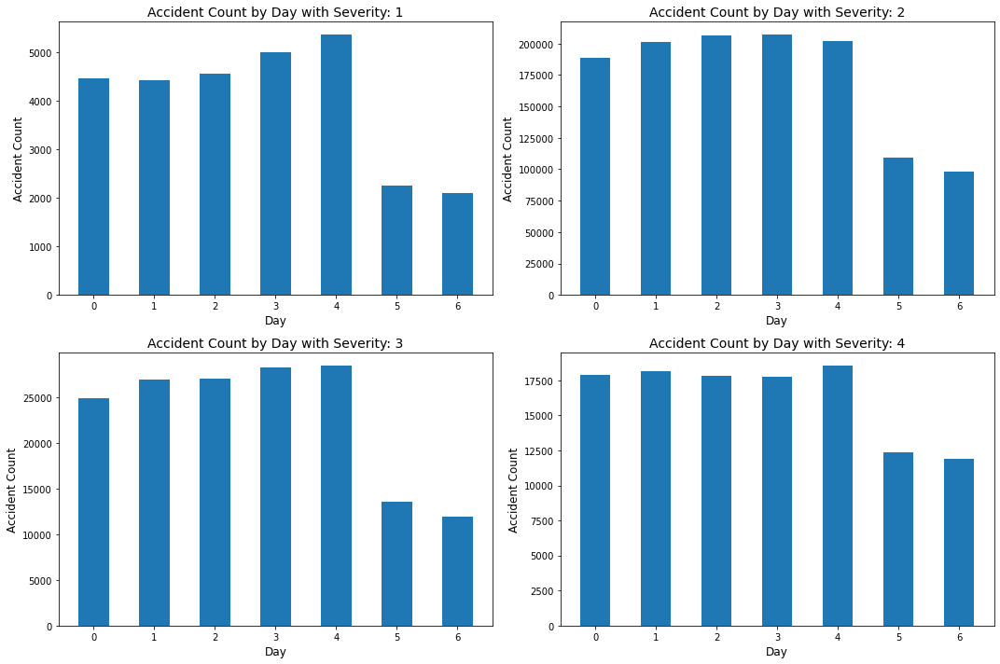

In [12]:
plt.subplots(2, 2, figsize = (15, 10))

for s in np.arange(1, 5):
    plt.subplot(2, 2, s)
    plt.hist(pd.DatetimeIndex(df.loc[df['Severity'] == s]['time']).dayofweek, bins = [0, 1, 2, 3, 4, 5, 6, 7],
            align = 'left', rwidth = 0.5)
    plt.title('Accident Count by Day with Severity: '+ str(s), fontsize = 14)
    plt.xlabel('Day', fontsize = 12)
    plt.ylabel('Accident Count', fontsize = 12)
    plt.xticks(fontsize = 10)
    plt.yticks(fontsize = 10)
    
plt.tight_layout()
plt.show()

There is a drop in the number of accidents for all severity levels during the weekend.

Is the distribution of accidents by hour the same on weekends as on weekdays?

[Text(0.5, 0, 'Hour of the day'), Text(0, 0.5, 'Accident Density')]

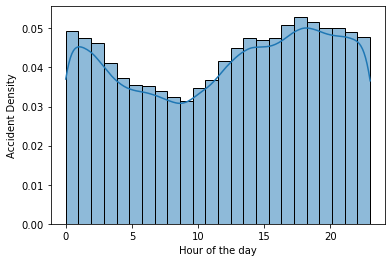

In [13]:
sundays_start_time = df.time[df.time.dt.dayofweek == 6]
sns.histplot(pd.DatetimeIndex(sundays_start_time).hour, bins = 24, stat = 'density', 
            kde = True).set(xlabel = 'Hour of the day', ylabel = 'Accident Density')

[Text(0.5, 0, 'Hour of the day'), Text(0, 0.5, 'Accident Density')]

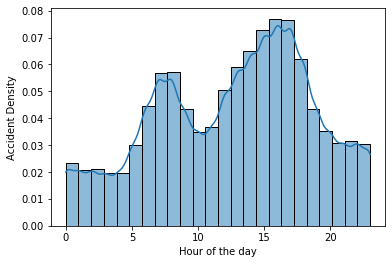

In [14]:
mondays_start_time = df.time[df.time.dt.dayofweek == 0]
sns.histplot(pd.DatetimeIndex(mondays_start_time).hour, bins = 24, stat = 'density', 
            kde = True).set(xlabel = 'Hour of the day', ylabel = 'Accident Density')

A major difference can be observed between the distribution of accidents throughout the day on a Sunday (weekend) as compared to that on a Monday (weekday)!

###### c. By most frequent weather conditions

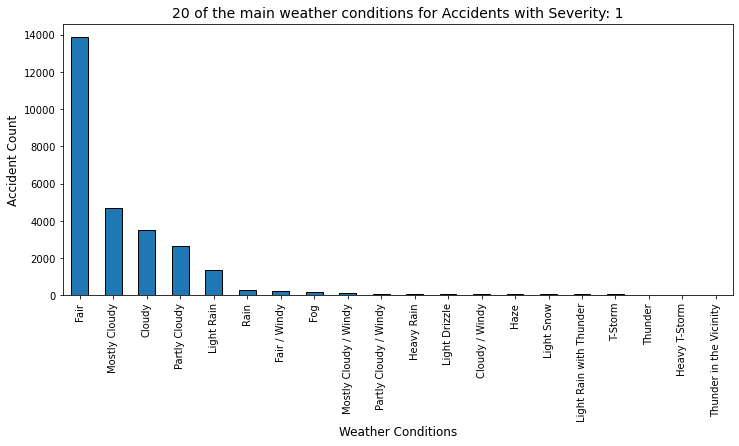

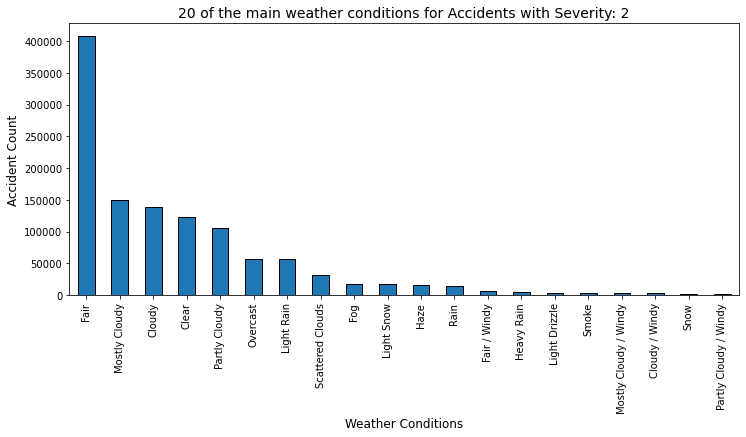

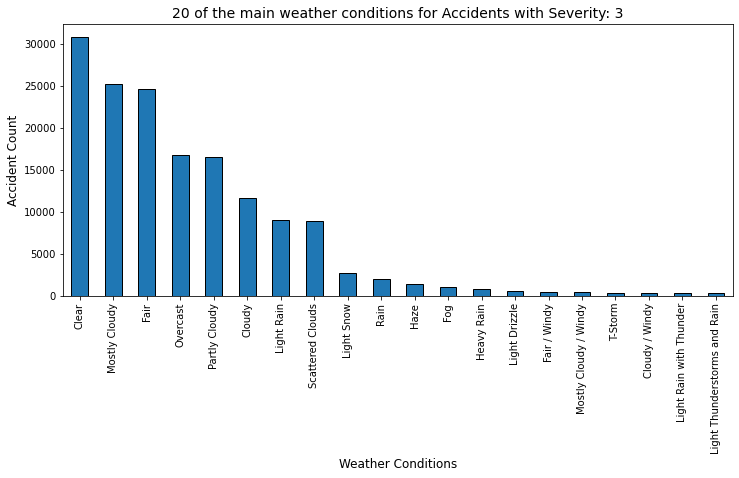

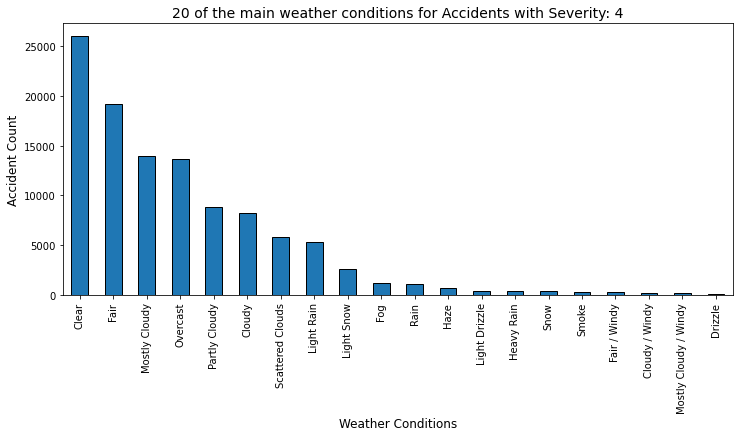

In [15]:
for s in np.arange(1, 5):
    plt.subplots(figsize = (12, 5))
    df.loc[df['Severity'] == s]['Weather_Condition'].value_counts().sort_values(ascending = False).head(20).plot.bar(width = 0.5, 
                                                                                                                     edgecolor = 'k',
                                                                                                                    linewidth = 1)
    plt.title('20 of the main weather conditions for Accidents with Severity: '+ str(s), fontsize = 14)
    plt.xlabel('Weather Conditions', fontsize = 12)
    plt.ylabel('Accident Count', fontsize = 12)
    plt.xticks(fontsize = 10)
    plt.yticks(fontsize = 10)

###### d. By fog, light rain, rain, heavy rain and snow

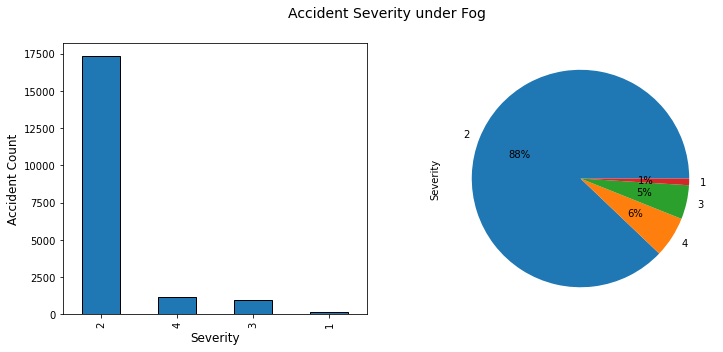

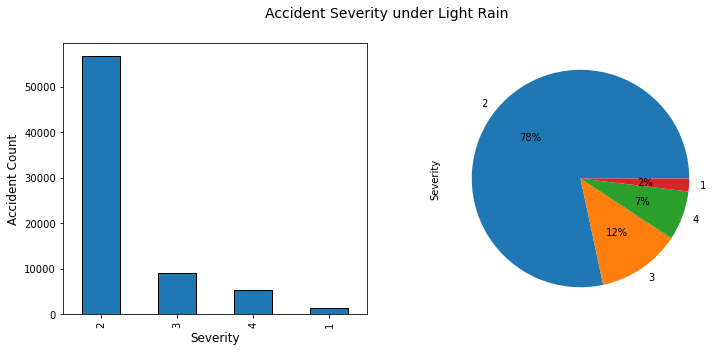

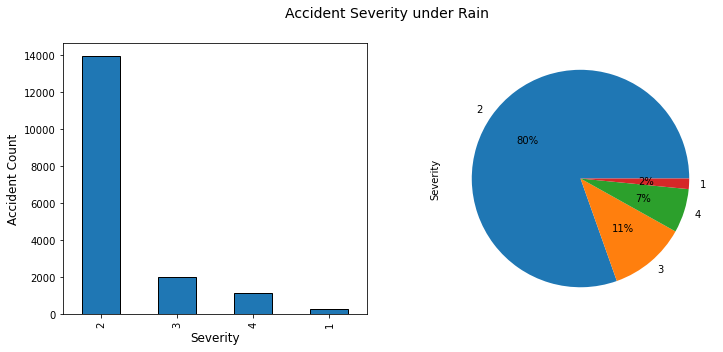

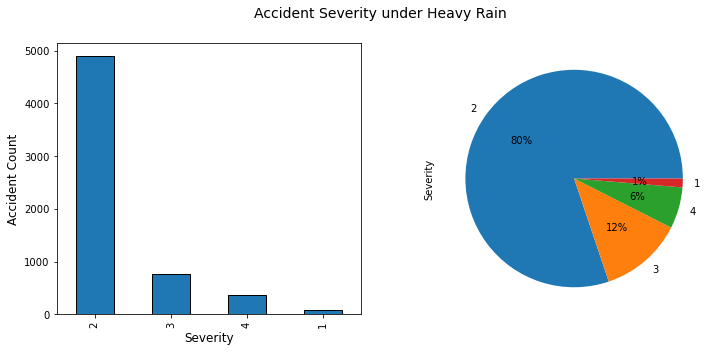

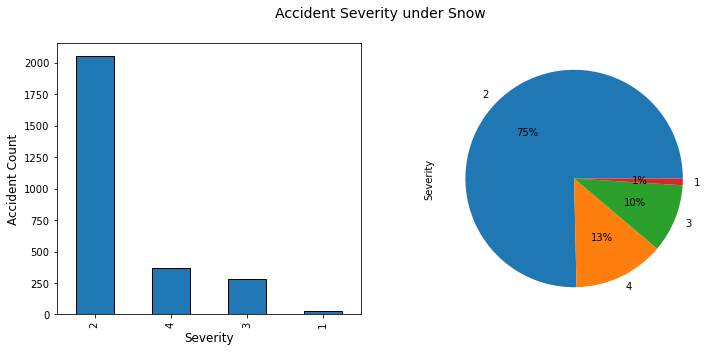

In [16]:
for s in ["Fog", "Light Rain", "Rain", "Heavy Rain", "Snow"]:
    plt.subplots(1, 2, figsize = (12, 5))
    plt.suptitle('Accident Severity under '+ s, fontsize = 14)
    
    plt.subplot(1, 2, 1)
    df.loc[df['Weather_Condition'] == s]['Severity'].value_counts().plot.bar(width = 0.5, edgecolor = 'k', linewidth = 1)
    plt.xlabel('Severity', fontsize = 12)
    plt.ylabel('Accident Count', fontsize = 12)
    plt.xticks(fontsize = 10)
    plt.yticks(fontsize = 10)
    
    plt.subplot(1, 2, 2)
    df.loc[df['Weather_Condition'] == s]['Severity'].value_counts().plot.pie(autopct = '%1.0f%%')

###### e. By other weather factors

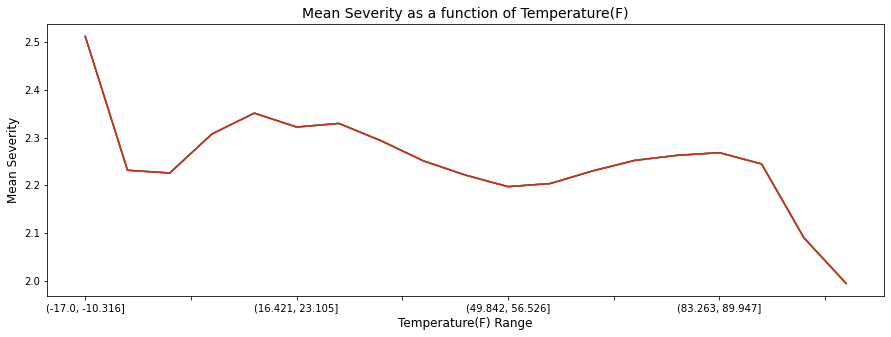

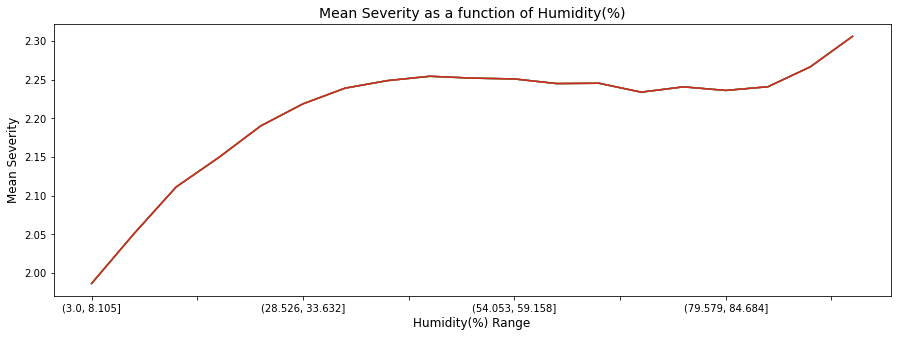

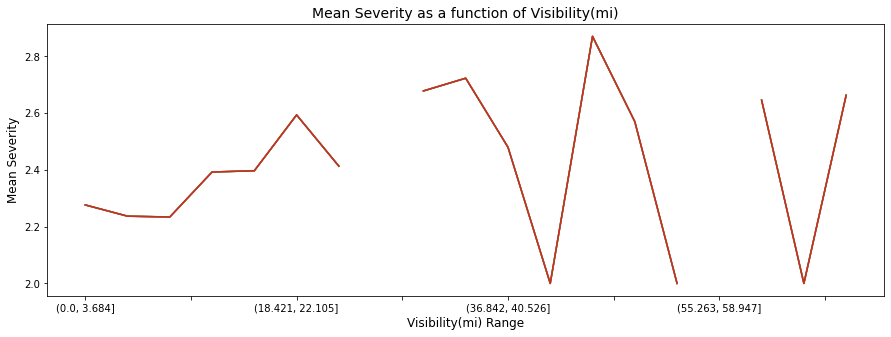

In [17]:
factors = ['Temperature(F)', 'Humidity(%)', 'Visibility(mi)']

for factor in factors:
    # remove the extreme values
    factorMin = df[factor].quantile(q = 0.0001)
    factorMax = df[factor].quantile(q = 0.9999)
    plt.subplots(figsize = (15, 5))
    
    for s in np.arange(1, 5):
        df["Severity"].groupby(pd.cut(df[factor], np.linspace(factorMin, factorMax, num = 20))).mean().plot() 
        plt.title("Mean Severity as a function of " + factor, fontsize = 14)
        plt.xlabel(factor + " Range", fontsize = 12)
        plt.ylabel('Mean Severity', fontsize = 12)
        plt.xticks(fontsize = 10)
        plt.yticks(fontsize = 10)

###### 2. Start Time

A histogram is a classic visualization tool that represents the distribution of one or more variables by counting the number of observations that fall within disrete bins.

A density plot (also known as kernel density plot) is another visualization tool for evaluating data distributions. It can be considered as a smoothed histogram. The peaks of a density plot help display where values are concentrated over the interval. There are a variety of smoothing techniques. Kernel Density Estimation (KDE) is one of the techniques used to smooth a histogram.

> stat = 'density' (normalize such that the total area of the histogram equals 1)

[Text(0.5, 0, 'Hour of the day'), Text(0, 0.5, 'Accident Density')]

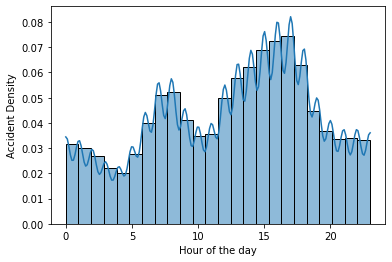

In [18]:
sns.histplot(pd.DatetimeIndex(df.time).hour, bins = 24, stat = 'density', 
            kde = True).set(xlabel = 'Hour of the day', ylabel = 'Accident Density')

###### 3. City & County (and hence, State)

In [19]:
cities_by_accident = df['City'].value_counts()
cities_by_accident.head(25)

Los Angeles       39984
Miami             36233
Charlotte         22203
Houston           20843
Dallas            19497
Sacramento        18431
Orlando           16169
Portland          14805
San Diego         14090
Minneapolis       12653
Atlanta           11854
Chicago           11507
Saint Paul        10084
Phoenix            9934
Raleigh            9516
San Jose           9362
Richmond           8472
Nashville          8381
Riverside          8201
Jacksonville       7815
Salt Lake City     7737
Kansas City        7500
Baton Rouge        7085
Austin             7038
Oakland            6978
Name: City, dtype: int64

According to https://worldpopulationreview.com/us-cities, the US city with the biggest population is New York City; however it is not present in the list of top 25 cities with the most number of accidents (assuming that the relationship between population and the number of accidents is somewhat directly proportional; also NYC is a metro city). Hence, I tried to find out why is that so.

In [20]:
'New York City' in df['City']
# 'New York' in df['City']
# 'NYC' in df['City']

False

In [21]:
'NY' in df['State']

False

So, it turns out that the dataset itself does not contain any data about New York state; hence the anomaly.

Text(0, 0.5, 'City')

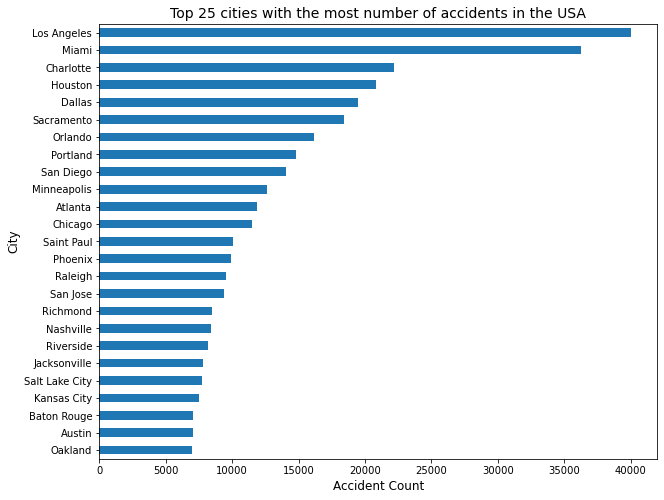

In [22]:
cities_by_accident[ : 25].sort_values().plot(kind = 'barh', figsize = (10, 8))
plt.title("Top 25 cities with the most number of accidents in the USA", fontsize = 14)
plt.xlabel("Accident Count", fontsize = 12)
plt.ylabel("City", fontsize = 12)
# plt.xticks(fontsize = 10)
# plt.yticks(fontsize = 10)

In [23]:
high_accident_cities = cities_by_accident[cities_by_accident >= 1000]
low_accident_cities = cities_by_accident[cities_by_accident < 1000]

(len(high_accident_cities) / len(cities_by_accident)) * 100

2.3552594538800786

Just 251 cities out of the total 10,657 cities (for which data is available) have more than 1000 accidents reported/recorded (from February 2016 to Dec 2020); which is just over 2% of the total cities.

[Text(0.5, 0, 'Accident Count'), Text(0, 0.5, 'City Count')]

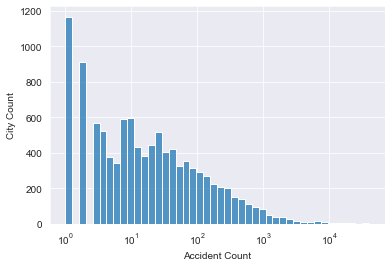

In [24]:
# Histogram plot for cities_by_accident

sns.set_style('darkgrid')
sns.histplot(cities_by_accident, log_scale = True).set(xlabel = 'Accident Count', ylabel = 'City Count')

In [25]:
cities_by_accident[cities_by_accident == 1]

Hazelhurst             1
Wasta                  1
Velarde                1
Hyden                  1
South Prince George    1
                      ..
Sunset Valley          1
Parrottsville          1
Lisbon Falls           1
Scribner               1
Maryland               1
Name: City, Length: 1167, dtype: int64

Over 1100 cities have just one accident reported/recorded over the course of four years (i.e. over 10% of the total cities); that needs to be investigaed further!

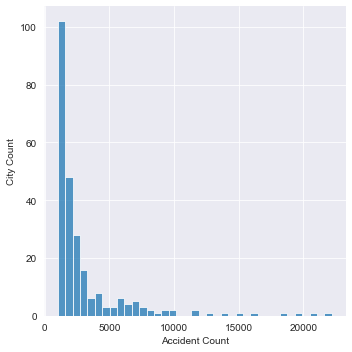

In [26]:
# sns.displot(high_accident_cities, stat = 'count')
sns.displot(high_accident_cities[high_accident_cities <= 25000], stat = 'count').set(xlabel = 'Accident Count', 
                                                                                     ylabel = 'City Count')

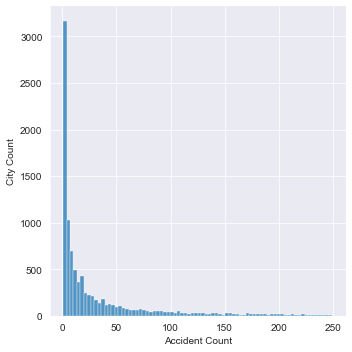

In [27]:
# sns.displot(low_accident_cities, stat = 'count')
sns.displot(low_accident_cities[low_accident_cities < 250], stat = 'count').set(xlabel = 'Accident Count', 
                                                                                ylabel = 'City Count')

###### HeatMap for Top 10 States using Folium

In [28]:
import folium
from folium.plugins import HeatMap

In [29]:
df1 = df[['State', 'Start_Lat', 'Start_Lng']]
df2 = df1.groupby('State',as_index = False).count().sort_values('Start_Lat', ascending = False).head(10)
list_df2 = df2['State'].to_list()
df3 = df1[df1['State'].isin(list_df2)]
df3_lat_long_pairs = list(zip(list(df3['Start_Lat']), list(df3['Start_Lng'])))

map = folium.Map()
HeatMap(df3_lat_long_pairs).add_to(map)
map
    